# FORD GO BIKE DATA ANALYSIS
## by Aswathy Nair

## Investigation Overview

> In Ford Go Bike Data Analysis,I wantto investigate factors affecting Renting bikes. The variables considered are Monthly,Weekdays, Hours, User Types, Gender, Duration  and Age groups that Bikes.

## Dataset Overview

> [GoBike System Data](https://s3.amazonaws.com/fordgobike-data/index.html) is used for analysis and visualization. This data set includes information about individual rides made in a bike-sharing system covering the greater San Francisco Bay area. 


In [1]:
# import all packages and set plots to be embedded inline
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sb 
import os
import glob 

%matplotlib inline

# suppress warnings from final output
import warnings
warnings.simplefilter("ignore")

In [2]:
# load in the dataset into a pandas dataframe
df = pd.read_csv('ford_bike_data_master.csv')

> Note that the above cells have been set as "Skip"-type slides. That means
that when the notebook is rendered as http slides, those cells won't show up.

## Trip Duration Distribuition

> Distribution is skewed right and clearly shows most of the trips have duration of 300 - 700 seconds.

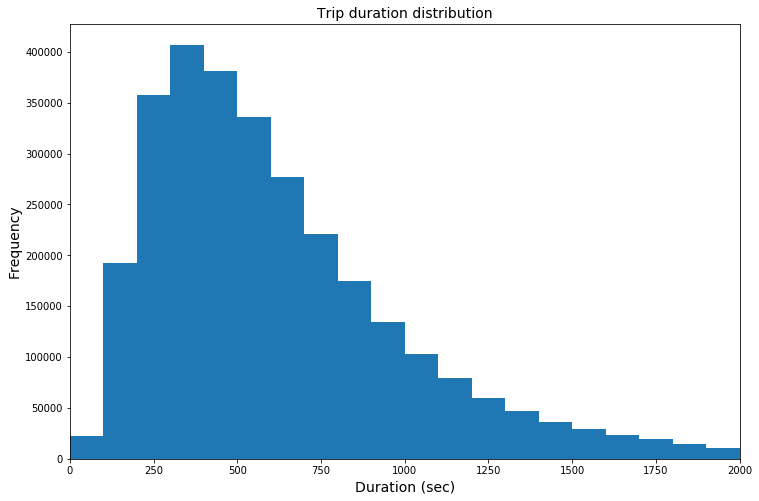

In [3]:
bins_edge = np.arange(0, df.duration_sec.max()+100, 100)

plt.figure(figsize=(12,8))
plt.hist(data=df, x='duration_sec', bins=bins_edge)
plt.xlim(0, 2000)
plt.xlabel('Duration (sec)',fontsize = 14);
plt.ylabel('Frequency', fontsize = 14);
plt.title('Trip duration distribution',fontsize=14);

## Distribution of Age Group on Rides

> Distribution shows major subscribers belong to age group 30 - 40

<Figure size 432x288 with 0 Axes>

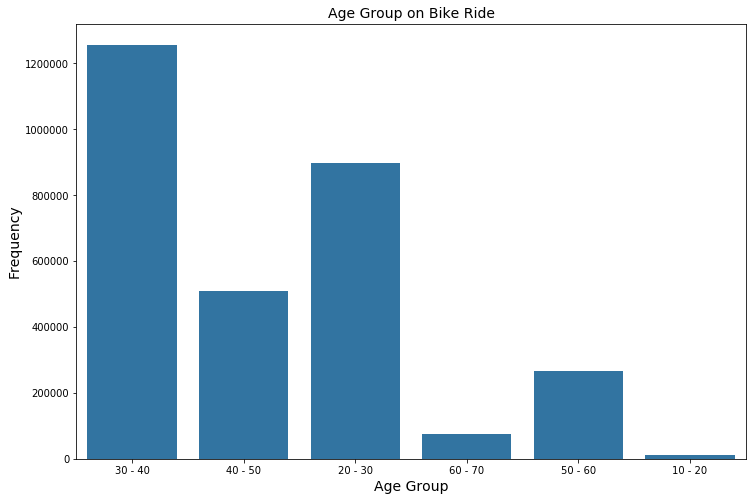

In [4]:
fig = plt.figure()
base_color = sb.color_palette()[0]
plt.figure(figsize=(12,8))
_ = sb.countplot(data = df, x = 'age_group', color = base_color)
plt.xlabel('Age Group',fontsize = 14);
plt.ylabel('Frequency',fontsize = 14);
plt.title('Age Group on Bike Ride',fontsize = 14);

## Bike Usage vs Hour of Day

> Distribution indicates 8- 9 AM and 4-6 PM is the peak hours for the ride.

<Figure size 432x288 with 0 Axes>

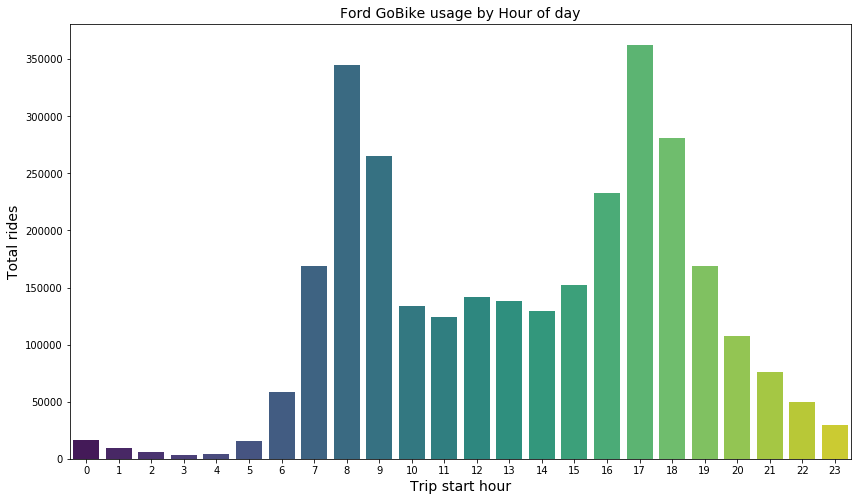

In [36]:
fig = plt.figure();
plt.figure(figsize=(14,8))
base_color = sb.color_palette()[0]
_ = sb.countplot(data=df, x='start_hour',palette='viridis')
plt.xlabel('Trip start hour',fontsize=14);
plt.ylabel('Total rides',fontsize =14);
plt.title('Ford GoBike usage by Hour of day',fontsize = 14);

## Distribution of Bike rides for Gender and User types

> Male gender are the main users of bike rides and of them major group belongs to subscibers

<Figure size 432x288 with 0 Axes>

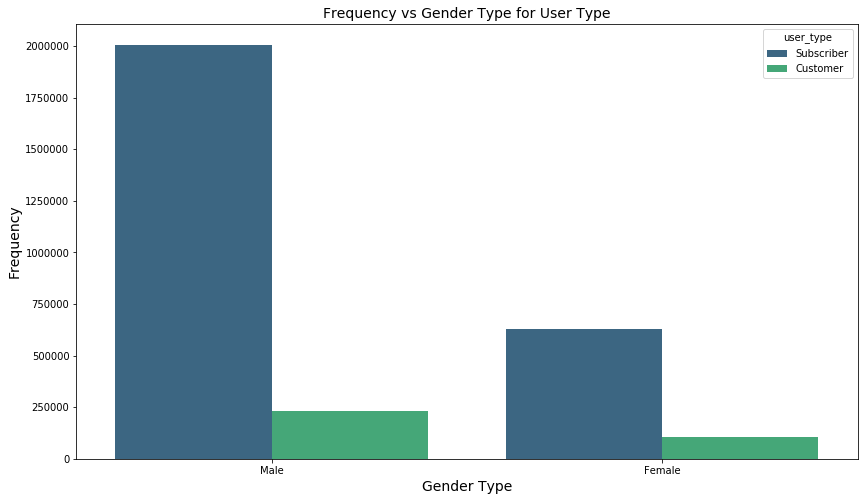

In [6]:
fig = plt.figure();
plt.figure(figsize=(14,8))
sb.countplot(data=df, x='member_gender', hue='user_type', palette='viridis')
plt.xlabel('Gender Type',fontsize = 14);
plt.ylabel('Frequency',fontsize = 14);
plt.title('Frequency vs Gender for User Type',fontsize = 14);


## Distribution of Ride Duration Monthly

> July 2017 has highest duration for rides considering Ford Go Bikes was launched in June 2017. Duration got and have monthly average of 750 seconds

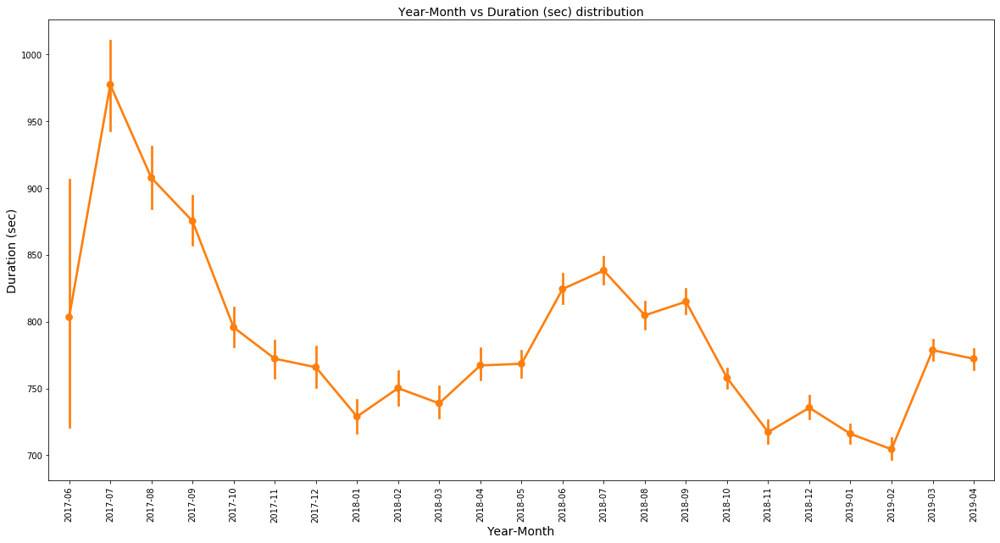

In [9]:
plt.figure(figsize = [20, 10]);
base_color = sb.color_palette()[1]
sb.pointplot(x="year_month", y="duration_sec",data=df.sort_values(by='year_month'), color=base_color);
plt.xticks(rotation = 90);
plt.xlabel("Year-Month",fontsize = 14);
plt.ylabel("Duration (sec)",fontsize = 14);
plt.title("Year-Month vs Duration (sec) distribution",fontsize = 14);

## Distribution of ride duration for Age groups on Weekdays

> Duration of rides are more during weekends especially for older age group

<Figure size 2160x1872 with 0 Axes>

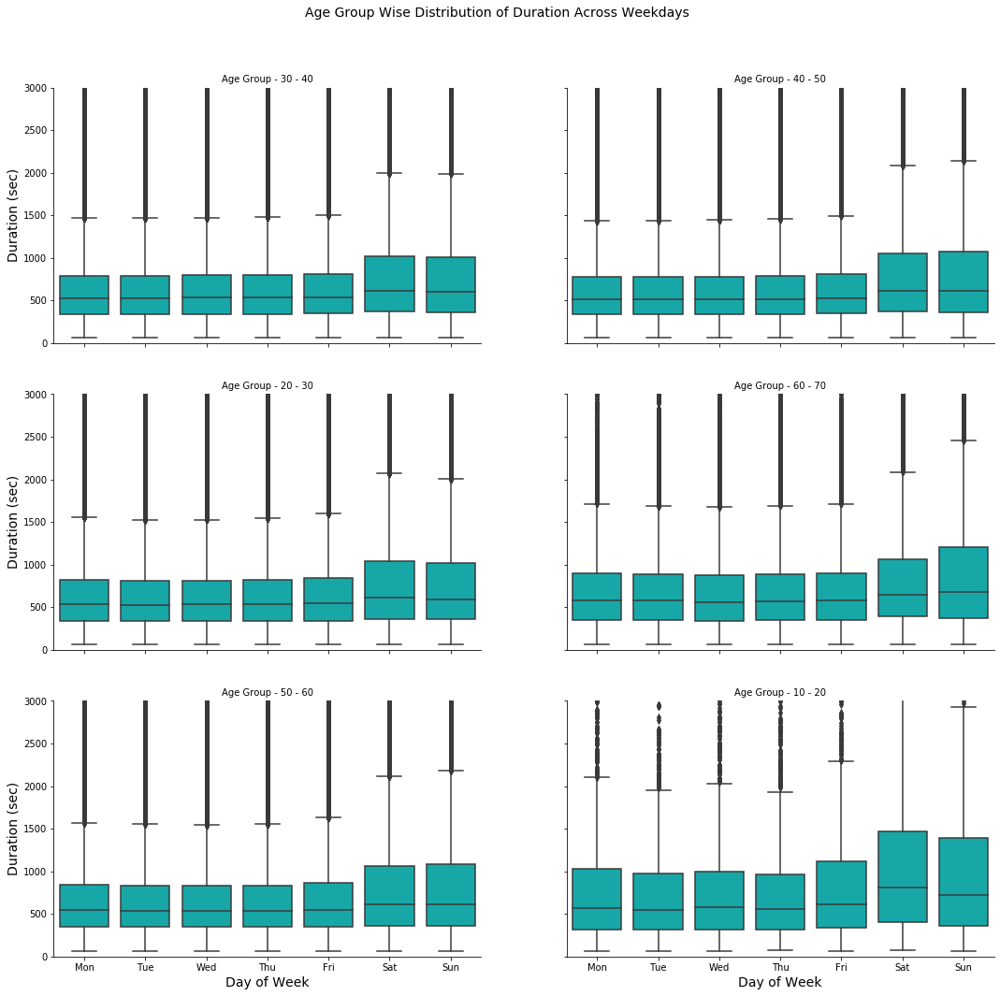

In [29]:
plt.figure(figsize = [30, 26]);
day_order = ['Mon','Tue','Wed','Thu','Fri','Sat','Sun']
g = sb.FacetGrid(data = df, col = 'age_group',col_wrap = 2,height = 5, aspect=1.5,margin_titles=True);
g.map(sb.boxplot, 'trip_weekday', 'duration_sec',order = day_order, color="c")

g.fig.subplots_adjust(wspace=.2, hspace=.2);
g.fig.subplots_adjust(top=.9);
g.set_titles(col_template = "Age Group - {col_name}",fontsize = 14);
g.fig.suptitle('Age Group Wise Distribution of Duration Across Weekdays ',fontsize = 14);
g.set_xlabels('Day of Week',fontsize = 14);
g.set_ylabels('Duration (sec)',fontsize = 14);

plt.ylim(0,3000);
plt.show();


## Distibution on usage duration on Gender and User type on Monthly 

> Customers ride duration is higher than subscribers and female gender ride more than male gender.

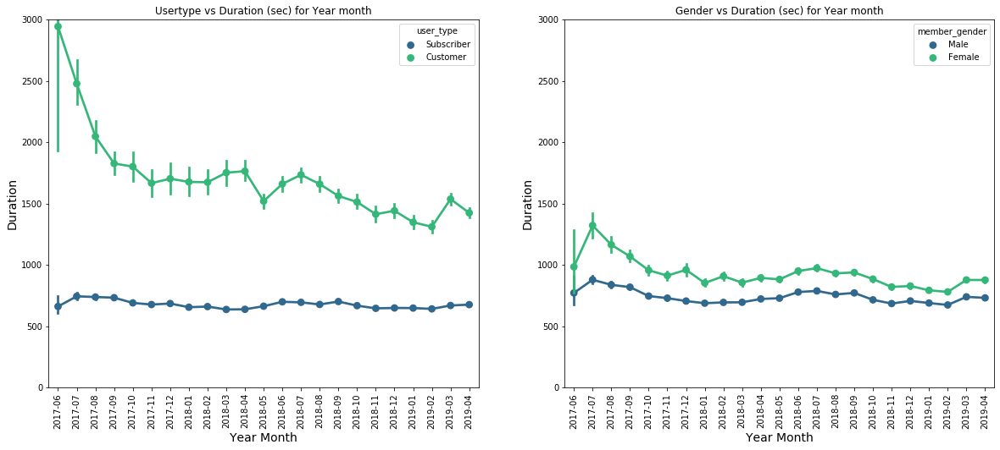

In [18]:
plt.figure(figsize=[20, 8])

plt.subplot(1, 2, 1)
sb.pointplot(data=df.sort_values(by='year_month'), x='year_month', y='duration_sec', hue='user_type', palette= 'viridis')
plt.xticks(rotation=90);
plt.ylim(0, 3000);
plt.xlabel('Year Month',fontsize = 14);
plt.title('Usertype vs Duration (sec) for Year month');
plt.ylabel('Duration',fontsize = 14);

plt.subplot(1, 2, 2)
sb.pointplot(data=df.sort_values(by='year_month'), x='year_month', y='duration_sec', hue='member_gender', palette='viridis')
plt.xticks(rotation=90);
plt.ylim(0, 3000);
plt.xlabel('Year Month',fontsize = 14);
plt.ylabel('Duration',fontsize = 14);
plt.title('Gender vs Duration (sec) for Year month');